In [58]:
import numpy as np
import pandas as pd

from sklearn.linear_model import Ridge, Lasso, ElasticNet, LinearRegression, RidgeCV, LassoCV, ElasticNetCV
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from sklearn.metrics import r2_score
from sklearn.preprocessing import StandardScaler

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

In [134]:
news = pd.read_csv('OnlineNewsPopularity.csv')
news.rename(columns=lambda x: x.strip(), inplace=True)

In [52]:
pd.set_option('display.max_columns',100,'display.max_rows',100,'display.max_colwidth',1000)

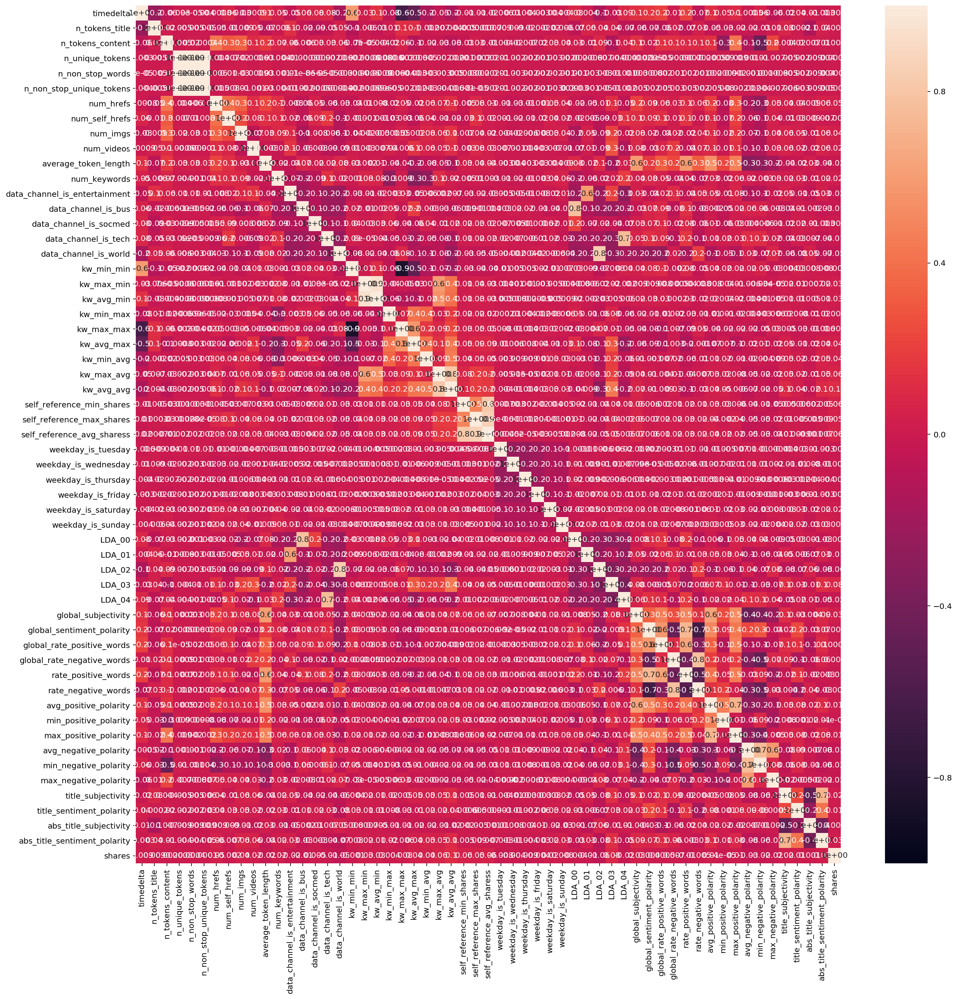

In [125]:
plt.figure(figsize=(20,20))
sns.heatmap(news.corr(),vmin=-1,vmax=1,annot=True, fmt='0.0')

In [45]:
news.head()

,url,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,http://mashable.com/2013/01/07/amazon-instant-video-browser/,731.0,12.0,219.0,0.663594,1.0,0.815385,4.0,2.0,1.0,0.0,4.680365,5.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,496.0,496.0,496.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.500331,0.378279,0.040005,0.041263,0.040123,0.521617,0.092562,0.045662,0.013699,0.769231,0.230769,0.378636,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,http://mashable.com/2013/01/07/ap-samsung-sponsored-tweets/,731.0,9.0,255.0,0.604743,1.0,0.791946,3.0,1.0,1.0,0.0,4.913725,4.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.799756,0.050047,0.050096,0.050101,0.050001,0.341246,0.148948,0.043137,0.015686,0.733333,0.266667,0.286915,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,http://mashable.com/2013/01/07/apple-40-billion-app-downloads/,731.0,9.0,211.0,0.575130,1.0,0.663866,3.0,1.0,1.0,0.0,4.393365,6.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,918.0,918.0,918.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.217792,0.033334,0.033351,0.033334,0.682188,0.702222,0.323333,0.056872,0.009479,0.857143,0.142857,0.495833,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,http://mashable.com/2013/01/07/astronaut-notre-dame-bcs/,731.0,9.0,531.0,0.503788,1.0,0.665635,9.0,0.0,1.0,0.0,4.404896,7.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.028573,0.419300,0.494651,0.028905,0.028572,0.429850,0.100705,0.041431,0.020716,0.666667,0.333333,0.385965,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,http://mashable.com/2013/01/07/att-u-verse-apps/,731.0,13.0,1072.0,0.415646,1.0,0.540890,19.0,19.0,20.0,0.0,4.682836,7.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,545.0,16000.0,3151.157895,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.028633,0.028794,0.028575,0.028572,0.885427,0.513502,0.281003,0.074627,0.012127,0.860215,0.139785,0.411127,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


In [46]:
news[['url','title_sentiment_polarity','abs_title_sentiment_polarity']]

,url,title_sentiment_polarity,abs_title_sentiment_polarity
0,http://mashable.com/2013/01/07/amazon-instant-video-browser/,-1.875000e-01,1.875000e-01
1,http://mashable.com/2013/01/07/ap-samsung-sponsored-tweets/,0.000000e+00,0.000000e+00
2,http://mashable.com/2013/01/07/apple-40-billion-app-downloads/,0.000000e+00,0.000000e+00
3,http://mashable.com/2013/01/07/astronaut-notre-dame-bcs/,0.000000e+00,0.000000e+00
4,http://mashable.com/2013/01/07/att-u-verse-apps/,1.363636e-01,1.363636e-01
5,http://mashable.com/2013/01/07/beewi-smart-toys/,2.142857e-01,2.142857e-01
6,http://mashable.com/2013/01/07/bodymedia-armbandgets-update/,0.000000e+00,0.000000e+00
7,http://mashable.com/2013/01/07/canon-poweshot-n/,5.000000e-01,5.000000e-01
8,http://mashable.com/2013/01/07/car-of-the-future-infographic/,0.000000e+00,0.000000e+00
9,http://mashable.com/2013/01/07/chuck-hagel-website/,0.000000e+00,0.000000e+00


In [47]:
# Set predictor variable, as excl. NLP and dupes:
news.drop(columns=['url','data_channel_is_lifestyle','weekday_is_monday','is_weekend'],inplace=True)
news.head()

,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,731.0,12.0,219.0,0.663594,1.0,0.815385,4.0,2.0,1.0,0.0,4.680365,5.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,496.0,496.0,496.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.500331,0.378279,0.040005,0.041263,0.040123,0.521617,0.092562,0.045662,0.013699,0.769231,0.230769,0.378636,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,731.0,9.0,255.0,0.604743,1.0,0.791946,3.0,1.0,1.0,0.0,4.913725,4.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.799756,0.050047,0.050096,0.050101,0.050001,0.341246,0.148948,0.043137,0.015686,0.733333,0.266667,0.286915,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,731.0,9.0,211.0,0.575130,1.0,0.663866,3.0,1.0,1.0,0.0,4.393365,6.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,918.0,918.0,918.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.217792,0.033334,0.033351,0.033334,0.682188,0.702222,0.323333,0.056872,0.009479,0.857143,0.142857,0.495833,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,731.0,9.0,531.0,0.503788,1.0,0.665635,9.0,0.0,1.0,0.0,4.404896,7.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.028573,0.419300,0.494651,0.028905,0.028572,0.429850,0.100705,0.041431,0.020716,0.666667,0.333333,0.385965,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,731.0,13.0,1072.0,0.415646,1.0,0.540890,19.0,19.0,20.0,0.0,4.682836,7.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,545.0,16000.0,3151.157895,0.0,0.0,0.0,0.0,0.0,0.0,0.028633,0.028794,0.028575,0.028572,0.885427,0.513502,0.281003,0.074627,0.012127,0.860215,0.139785,0.411127,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


In [137]:
# Set X and y
X = news.loc[:,'timedelta':'abs_title_sentiment_polarity']
y = news[['shares']]

In [138]:
# train-test-split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=1)

In [139]:
# standardize X_train:
scaler = StandardScaler()    # instantiate the StandardScaler class

X_train_std = scaler.fit_transform(X_train)     # call .fit_transform() method on X_train
X_train = pd.DataFrame(X_train_std,columns=X_train.columns)     # turn the standardized data into a dataframe

# For X_test, make sure to only 'transform' not 'fit_transform'!
X_test_std = scaler.transform(X_test)
X_test = pd.DataFrame(X_test_std,columns=X_test.columns)

In [140]:
# Build the linear regression for y based on standardized X:
lr = LinearRegression()
lr.fit(X_train, y_train)

print(lr.score(X_train,y_train))
print(lr.score(X_test,y_test))

0.02181873393179823
0.031202552240341408


In [141]:
# CVScore:
kf = KFold(n_splits=10, shuffle=True, random_state=1)
scores = cross_val_score(lr, X_train, y_train, cv=kf)
scores

array([-3.78420810e+17,  2.12545489e-03,  1.05781853e-02,  1.53054084e-02,
        1.50798555e-02,  3.47214433e-02,  5.42781880e-03,  2.34252781e-02,
        1.46224253e-02,  4.69298161e-02])

In [142]:
shares_corr = pd.concat([X,y],axis=1).corr()[['shares']].drop('shares')
betas = pd.concat([pd.DataFrame(X_train.columns), pd.DataFrame(lr.coef_).T],axis=1)
betas.columns = ['X_train','slr model.coef_']

betas = betas.set_index('X_train')
betas['shares_corr'] = shares_corr

betas

,slr model.coef_,shares_corr
X_train,,
timedelta,4.309838e+02,0.008662
n_tokens_title,2.601693e+02,0.008783
n_tokens_content,3.906372e+02,0.002459
n_unique_tokens,1.345562e+04,0.000806
n_non_stop_words,-1.144685e+04,0.000443
n_non_stop_unique_tokens,-5.572810e+03,0.000114
num_hrefs,3.076628e+02,0.045404
num_self_hrefs,-2.685170e+02,-0.001900
num_imgs,3.476271e+01,0.039388


In [147]:
betas[['shares_corr']]

,shares_corr
X_train,
timedelta,0.008662
n_tokens_title,0.008783
n_tokens_content,0.002459
n_unique_tokens,0.000806
n_non_stop_words,0.000443
n_non_stop_unique_tokens,0.000114
num_hrefs,0.045404
num_self_hrefs,-0.001900
num_imgs,0.039388


In [143]:
# Let's test what ElasticNet teaches us about collinearity?
elastic = ElasticNetCV(l1_ratio=[0.0001, 0.001, 0.01, 0.1, 0.5, 0.7, 0.9, 0.95, 0.99, 1],
                     alphas=np.logspace(-5, 5, 100), cv=kf)
elastic.fit(X_train, y_train)
print(elastic.alpha_)
print(elastic.l1_ratio_)

# we see it's highly Lasso'd ... ie. L1 = 1, hence there are too many predictors:

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:1100: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11362149587.231934, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292303947600.47314, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20851158050.316895, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1011763231110.3765, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2183976341403.9734, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2277428659549.441, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21486136475.919434, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 883783828447.002, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12134102711.492676, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 741972307761.5583, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1907657907264.9937, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28680047256.007324, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1010844940121.9478, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2111877235375.4788, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30182515938.15381, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1181114112711.3809, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2210786459338.472, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2286072935977.579, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2286064733406.871, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32351316927.628906, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8602011022.69043, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 765868865146.6477, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1920199173416.4265, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28556561479.480957, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1013312039565.2712, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1882628707047.5088, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26917988566.745605, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 979731630649.1138, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2165235889332.6658, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6488001536.413086, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 95481120280.0581, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 450009969513.8384, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2239347063012.466, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2272669747704.252, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2276306771284.9717, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1935318503784.7397, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1935312449128.4392, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1935306845635.6003, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2011937963221.9482, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2011933992512.054, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2011930324308.7144, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 94940315233.16504, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1671291649478.6729, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2189673062022.7837, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 431444632.4291992, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 123917808470.49658, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1496312032610.5322, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1885120834714.1626, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1983098570945.451, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2028178157109.8567, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1944122425219.0955, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1944110418310.959, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1944099098084.6345, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2254793452663.5376, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2254787716450.109, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2254782450656.3237, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2190454420979.2175, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 894064483.7480469, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 256687301637.3291, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2277427249690.4824, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 872039986.3349609, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 240383145709.0464, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 473570418.64453125, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 162712374697.16504, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 581483497064.605, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1930839233087.8528, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2155123830712.042, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2184505671414.1902, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1290541734429.9517, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1990049096820.0884, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2245542049375.987, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1935843410328.786, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1936126497521.999, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1936250942241.321, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective di

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2034518216158.8293, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2034515062699.5034, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2034512080379.157, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1944067945536.1873, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1944059495396.7998, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1231759844.9716797, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objectiv

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2254775913328.163, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2254771814697.533, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1082998308.0009766, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objectiv

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2277414298247.918, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 631848888112.0923, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1675650991265.035, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 828301688410.3779, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1902051402130.0684, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2088748100467.9558, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2281166234739.957, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2283152130069.839, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2284274123727.4307, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 874266946.2089844, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1609922255496.4087, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1888502774825.5706, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 781037710330.521, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1945388205498.6626, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2137895731906.9607, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objectiv

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 49092165391.464355, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 966930007097.5918, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1724037545782.904, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 60217038995.759766, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 885184754251.8552, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1498552763597.0845, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29750813977.088867, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 717291051485.9585, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1423430060461.8496, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2154752358970.4521, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2170165583241.7524, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2179548374539.7017, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36084646320.65381, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1008468254780.6577, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1595255291674.9033, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11800037145.192383, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623509528888.1948, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1378051818568.2974, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 66808091330.0166, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 977537167603.2217, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1564158463350.7678, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective di

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 103298207038.74463, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1060707278897.3787, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1746146307519.6953, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9819016636.404297, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11778019269.414062, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18614101797.59375, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objectiv

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42765077486.316895, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 574142413236.4265, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1216181969805.646, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objectiv

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22359508231.819824, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 426205203838.67505, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1086086665692.3099, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 700077404119.7285, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1393318776272.9878, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1771941040860.7275, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1510071272117.129, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1898496154884.5679, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2077018924459.6274, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40525312634.723145, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 703246157005.8035, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1360134251069.3145, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12190423575.261719, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 358547583173.24854, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1025288612199.4568, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1306855349022.2944, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1626678908762.1475, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1772827664483.8167, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 64654210205.99463, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 688778533587.5874, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1413944897835.2222, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objectiv

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8250451061.300293, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9443839983.194336, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10537820070.205078, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objectiv

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2276935632210.6455, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2277017843510.2954, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2277083659993.0127, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1934807492645.0002, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1934892667164.6687, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1934960396558.4026, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2009450732197.294, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2009970651185.7144, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2010371756149.76, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective di

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2194176192611.0193, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2195132187474.8025, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2195855607605.1995, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2284690514276.1245, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2284968738159.1523, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2285182644118.7354, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1935618004487.997, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1935690116737.0984, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1935745468224.694, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2034055403871.0122, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2034132019095.6733, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2034193868937.6633, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1133224596.7050781, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 70838141475.30225, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 415618246014.28613, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2254453510890.271, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2254502630206.7886, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2254542567561.7676, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2271474868077.363, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2272767214359.5347, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2273745458251.5977, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1933357253083.8477, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1933735209305.4216, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1934031180331.6377, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2007770859206.528, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2008626371766.7327, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2009287568109.564, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2192923937189.756, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2194096722067.3572, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2194997611025.4204, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2282346713427.944, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2283131026631.772, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2283731387644.4927, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1935870343052.3464, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5580227459.878418, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 66639850500.21631, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2034232204520.7063, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2034272837552.4106, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18940152266.22168, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objectiv

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18342214356.384766, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 151574535261.76318, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 479799598618.5215, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1732833907.4990234, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20504093206.655273, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 112087230277.43506, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2273057671861.8, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2273825640582.6777, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2274446281894.7554, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective di

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1919152247202.2769, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1922472737478.5454, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1924996770199.5762, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1997994606192.8809, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2000737921481.7778, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2002887671872.6196, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2193335712139.3464, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2194235881167.4753, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2194971999768.7493, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2284654210626.9, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2284874827855.9453, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2285056902083.9165, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective di

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1929904448788.445, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1931102523760.196, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1932040825568.431, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective di

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2025400683471.1462, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2027107495335.6768, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2028464467798.3176, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1938723925491.9702, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1939718474220.2114, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1940508031517.1536, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2245749996330.012, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2247419743174.3975, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2248774884680.86, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 86267621786.42285, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 86267617016.1294, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 86267614651.12354, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2276356826598.399, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2276508447932.7686, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 65132382037.30762, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1933859460658.5437, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1934066770057.7732, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1934243241277.8748, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1972874582834.8098, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1978960344265.599, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1984058912985.4414, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2157075279153.031, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2163563595456.5674, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2168992757268.2927, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2279958550571.058, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2280860458323.4287, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2281626497195.2856, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1906956597191.1143, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1911432144880.6868, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1915195396804.6782, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2029142187513.4429, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2029940171202.9705, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2030618096921.9314, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1940316335591.0012, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1940862285237.424, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1941326449180.0032, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2249146849889.161, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2249981396891.943, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2250690408819.921, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

11.497569953977356
1.0


In [111]:
enet = ElasticNet(alpha=elastic.alpha_, l1_ratio=elastic.l1_ratio_)
enet_scores = cross_val_score(enet, X, y, cv=kf)

print(enet_scores)
print(np.mean(enet_scores))

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 90140271454.73535, tolerance: 501236834.8570905
  positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1967268520549.2234, tolerance: 430200586.23679584
  positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2007371043616.3137, tolerance: 465102821.898169
  positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the numbe

[ 0.02599178  0.04393817  0.00756182  0.01115102 -1.9185012   0.04492709
  0.01303064  0.0342629   0.02621008  0.01191326]
-0.16995144224361902


/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:475: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1798557546662.554, tolerance: 462706558.5088721
  positive)


In [113]:
# Redo for subjectivity and sentiment:
X = news.loc[:,'LDA_00':'abs_title_sentiment_polarity']

In [114]:
# train-test-split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=1)

In [115]:
# standardize X_train:
scaler = StandardScaler()    # instantiate the StandardScaler class

X_train_std = scaler.fit_transform(X_train)     # call .fit_transform() method on X_train
X_train = pd.DataFrame(X_train_std,columns=X_train.columns)     # turn the standardized data into a dataframe

# For X_test, make sure to only 'transform' not 'fit_transform'!
X_test_std = scaler.transform(X_test)
X_test = pd.DataFrame(X_test_std,columns=X_test.columns)

In [116]:
# Build the linear regression for y based on standardized X:
lr = LinearRegression()
lr.fit(X_train, y_train)

print(lr.score(X_train,y_train))
print(lr.score(X_test,y_test))

0.009692722694898848
0.016037217859851127


In [117]:
# Let's test what ElasticNet teaches us about collinearity?
elastic = ElasticNetCV(l1_ratio=[0.0001, 0.001, 0.01, 0.1, 0.5, 0.7, 0.9, 0.95, 0.99, 1],
                     alphas=np.logspace(-5, 5, 100), cv=kf)
elastic.fit(X_train, y_train)
print(elastic.alpha_)
print(elastic.l1_ratio_)

# we see it's highly Lasso'd ... ie. L1 = 1, hence there are too many predictors:

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:1100: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11606005741.749023, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 157393775189.64844, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1961134908790.9104, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1961134750624.225, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1961134616831.3655, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1768146459.8554688, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300405973764.85596, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1767931522393.1719, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2312890514734.675, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2313619929374.9204, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2313878032692.0356, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3244560214.8930664, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 423210016704.38965, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1680390245735.3223, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1458944204.9291992, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 252303217529.35596, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1547742924419.542, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2728137217.0981445, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24375703146.243164, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 108303780052.66064, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2306217485483.708, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2306286655822.14, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2306327602668.255, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2038011785059.5083, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2038199091348.7449, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2038299385573.934, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6072233031.283691, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331050827091.71094, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1577921337924.5002, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1964316611548.4314, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1964317219876.3728, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1964317688345.0374, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5590660695.053223, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296047382335.05225, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1374209009955.6296, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2281888964374.6035, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2281889709869.7124, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2281890286279.8325, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22105226017.24707, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 435346210556.9326, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1445883772012.5295, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22587066314.60547, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 420419697721.3291, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1319068038452.9495, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8768418777.85498, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 231365298381.2212, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1402345023508.371, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17691336495.36328, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 361917551301.1045, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1255407674013.17, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9407213984.746582, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 242996774627.83496, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1134972305544.945, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objectiv

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2606925641.137207, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2665243913.0820312, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2712071570.8061523, tolerance: 457692353.01669544
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1251200266.559082, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36841823485.7041, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328990514056.54736, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2037371466042.9138, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2037594667532.305, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2037761147749.396, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13906823818.315918, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296824787530.7793, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 997362422674.9236, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 932238165.9243164, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27760853469.802246, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 273514347374.05078, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472050798.2519531, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14951501681.160156, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 175868870218.4209, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objectiv

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1831748913476.4985, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2010213920666.506, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2117330366363.1775, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2727109916.8984375, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32120507864.287598, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 186269384013.30566, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27687224419.53125, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 169482499092.542, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 542426097432.0957, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2097586874.0219727, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25296409336.334473, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 153933082125.75977, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1977699031055.8516, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2087371816421.8433, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2154080998919.6084, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 913410451.9306641, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10607939393.287598, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 69199692049.67432, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7290404497.834961, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 67707032178.54004, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 260510531346.00586, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9016493455.211914, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 60796600076.72461, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 240026338569.19775, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3662133074.8964844, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26351919559.779785, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 116458705162.34619, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2034452727636.5374, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2038775134997.213, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2042046547703.1824, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2277377109888.923, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2277883215114.326, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2278311546876.807, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1923524742277.088, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1929740062003.9631, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1934639185988.3296, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2040329240466.392, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2083178654169.682, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2114493367245.7441, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1259875910.2094727, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7565498933.303223, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32467879925.410645, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1945775910702.8167, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1968672284052.2488, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1985851639711.393, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objecti

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2255236339483.3716, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2258755152005.759, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2261652192943.099, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objectiv

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2283281661606.3965, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2285455759252.5605, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2287347031101.479, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 871680738.7924805, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5305480648.10791, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23450416810.708008, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective di

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2212230082844.431, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2213335717478.3423, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4460873548.621094, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308876813159.75146, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 544606256271.5615, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 796101180024.815, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective di

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1752310685.0478516, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 618549161.0283203, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 56018078377.04492, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1618172846.9804688, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11954451010.44336, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34647659287.601074, tolerance: 465822226.8088746
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799025031733.4619, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 973372027259.668, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1130397765477.549, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 159355647047.7251, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 278429468663.62256, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 433989139358.2622, tolerance: 411707097.8685818
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective d

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1858667414930.5847, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1910610762670.856, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1953411031444.9856, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1267868042.9975586, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11473362371.432129, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 98504066075.19678, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 914084245555.6938, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1082948911488.0591, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1232955734835.555, tolerance: 415463845.58444506
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objectiv

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1849964151650.9377, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1861835531027.4185, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1870123524261.3708, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2235868629061.722, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2238952949740.947, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2241762625375.624, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1313607359324.8474, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1280863422219.9321, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1344219170580.5356, tolerance: 396532431.05198175
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Object

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1202002766860.2473, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1278073165537.623, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1346509928046.4814, tolerance: 449438069.9307275
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1499941161741.1792, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1554797700351.038, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1604752076079.4746, tolerance: 467188855.3274803
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1756214506311.6804, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1768332069381.062, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1779556854008.7146, tolerance: 397056034.8772955
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective 

/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1110370929542.5022, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1172899323907.2002, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1229290876838.4119, tolerance: 397867956.7953397
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective

11.497569953977356
1.0


/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1869527660586.644, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1898310362603.555, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1924355281444.3127, tolerance: 460447970.06389385
  tol, rng, random, positive)
/Users/Noah/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/coordinate_descent.py:471: ConvergenceWarning: Objectiv

In [144]:
enet = ElasticNet(alpha=elastic.alpha_, l1_ratio=elastic.l1_ratio_)
enet_scores = cross_val_score(enet, X_train, y_train, cv=kf)

print(enet_scores)
print(np.mean(enet_scores))

[0.03660436 0.00322529 0.0102258  0.01514587 0.02306356 0.03688356
 0.00678342 0.02321926 0.01482964 0.04822054]
0.02182012813256743


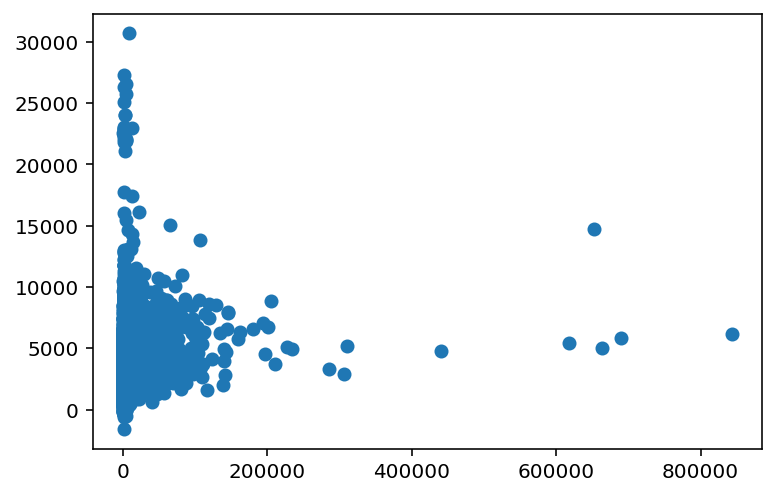

In [145]:
yhat = elastic.predict(X_train)
plt.scatter(y_train, yhat);

In [121]:
sns.pairplot(pd.concat([X,y],axis=1))

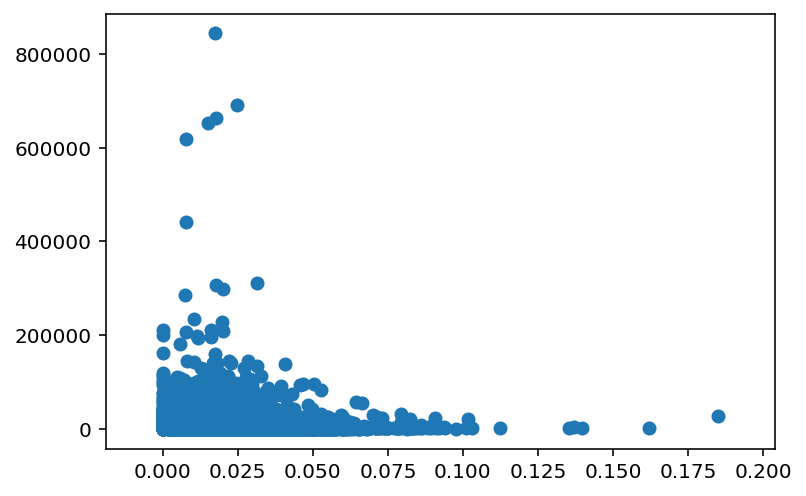

In [123]:
plt.scatter(x=news['global_rate_negative_words'],y=news['shares'])

In [136]:
news.sort_values('shares',ascending=False)

,url,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
9365,http://mashable.com/2013/07/03/low-cost-iphone/,554.0,12.0,688.0,0.500734,1.0,0.643357,28.0,3.0,15.0,1.0,4.893895,6.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1100.0,225.500000,2800.0,690400.0,430716.666667,1700.000000,5117.417323,3753.110567,2100.0,40000.0,17066.666667,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.034464,0.034359,0.033335,0.699919,0.197924,0.503345,0.186037,0.059593,0.017442,0.773585,0.226415,0.336022,0.050000,1.000000,-0.217593,-0.400000,-0.050000,0.100000,-0.300000,0.400000,0.300000,843300
5370,http://mashable.com/2013/04/15/dove-ad-beauty-sketches/,633.0,11.0,893.0,0.517202,1.0,0.716730,17.0,11.0,0.0,11.0,4.586786,6.0,0.0,0.0,1.0,0.0,0.0,0.0,4.0,10100.0,1937.666667,10100.0,617900.0,280433.333333,2874.870600,10100.000000,5083.768906,705.0,17300.0,5099.111111,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.701874,0.033383,0.033334,0.198075,0.033333,0.450678,0.100533,0.047032,0.024636,0.656250,0.343750,0.421230,0.033333,1.000000,-0.348674,-1.000000,-0.100000,0.000000,0.000000,0.500000,0.000000,690400
23237,http://mashable.com/2014/04/09/first-100-gilt-soundcloud-stitchfix/,274.0,13.0,2591.0,0.237708,1.0,0.371091,27.0,4.0,1.0,1.0,4.588962,10.0,0.0,0.0,0.0,0.0,1.0,0.0,-1.0,623.0,140.800000,2300.0,843300.0,165680.000000,1441.000000,3953.929636,2860.284775,1100.0,20700.0,10875.000000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.354915,0.122336,0.020140,0.020044,0.482565,0.415273,0.075724,0.028174,0.017754,0.613445,0.386555,0.349033,0.033333,0.800000,-0.315761,-0.500000,-0.050000,0.535714,0.285714,0.035714,0.285714,663600
16268,http://mashable.com/2013/11/18/kanye-west-harvard-lecture/,416.0,9.0,134.0,0.689394,1.0,0.851852,1.0,1.0,0.0,2.0,4.082090,7.0,0.0,0.0,1.0,0.0,0.0,0.0,4.0,6100.0,1139.285714,1700.0,843300.0,540557.142857,1500.000000,15250.000000,5270.699017,298400.0,298400.0,298400.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.600988,0.172973,0.028572,0.168895,0.028572,0.556854,0.004040,0.037313,0.014925,0.714286,0.285714,0.287273,0.100000,0.500000,-0.700000,-1.000000,-0.400000,0.000000,0.000000,0.500000,0.000000,652900
3145,http://mashable.com/2013/03/02/wealth-inequality/,677.0,11.0,382.0,0.487805,1.0,0.605809,15.0,3.0,11.0,1.0,4.777487,8.0,0.0,0.0,0.0,0.0,0.0,0.0,217.0,414.0,324.375000,16800.0,227300.0,103937.500000,1729.598540,5052.375000,3039.782050,1500.0,16600.0,9050.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.025018,0.025016,0.275011,0.649953,0.025002,0.340229,0.125005,0.034031,0.007853,0.812500,0.187500,0.292957,0.033333,0.700000,-0.277778,-0.433333,-0.200000,0.000000,0.000000,0.500000,0.000000,617900
16009,http://mashable.com/2013/11/12/roomba-880-review/,422.0,8.0,261.0,0.571429,1.0,0.595628,24.0,5.0,18.0,1.0,5.157088,9.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,525.0,128.222222,5500.0,843300.0,395900.000000,1341.804878,6089.276625,3647.871244,4800.0,6900.0,5850.000000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.022225,0.022361,0.144485,0.568972,0.241957,0.465565,0.157748,0.022989,0.007663,0.750000,0.250000,0.337121,0.100000,1.000000